# 0.0 IMPORTS

In [73]:
import math
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn import preprocessing as pp
from sklearn.ensemble import RandomForestRegressor
from boruta import BorutaPy
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error
import plotly.graph_objects as go
warnings.filterwarnings('ignore')

## 0.1 Helper Functions

In [2]:
def jupyter_settings():
    %matplotlib inline
    %pylab inline
    
    plt.style.use('bmh')
    plt.rcParams['figure.figsize'] = [25, 12]
    plt.rcParams['font.size'] = 24
    
    #display(HTML('<style>.container {width:100% !important; }</style>'))
    #pd.options.display.max_columns = None
    #pd.options.display.max_rows    = None
    #pd.set_option('display.expand_frame_repr', False)
    
    sns.set()

def ml_error(model_name, y, yhat):
    mae  = mean_absolute_error(y, yhat) 
    mape = mean_absolute_percentage_error(y, yhat)
    rmse = np.sqrt(mean_squared_error(y, yhat))
    
    return pd.DataFrame({'Model Name': model_name,
                         'MAE': mae,
                         'MAPE': mape,
                         'RMSE': rmse}, index = [0])

layout = go.Layout(autosize=False, width=800, height=250,
                   margin=go.layout.Margin(l=10, r=10, b=10, t=10, pad = 6))

In [3]:
jupyter_settings()

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


## 0.2 Loading Data

In [4]:
# código referente aos dados do site INMET

df_aux = pd.read_csv('datasets/clima/br.csv')

df_aux = df_aux[['Data', 'Hora (UTC)', 'Radiacao (KJ/m²)']]
df_aux['Data'] = pd.to_datetime(df_aux['Data'], dayfirst=True)

df_aux['Data'] = df_aux[['Data', 'Hora (UTC)']].apply(lambda x:                                             
                                        x['Data'] + pd.to_timedelta('0 hours') if x['Hora (UTC)'] == 0 else 
                                        x['Data'] + pd.to_timedelta('1 hours') if x['Hora (UTC)'] == 100 else 
                                        x['Data'] + pd.to_timedelta('2 hours') if x['Hora (UTC)'] == 200 else
                                        x['Data'] + pd.to_timedelta('3 hours') if x['Hora (UTC)'] == 300 else
                                        x['Data'] + pd.to_timedelta('4 hours') if x['Hora (UTC)'] == 400 else
                                        x['Data'] + pd.to_timedelta('5 hours') if x['Hora (UTC)'] == 500 else
                                        x['Data'] + pd.to_timedelta('6 hours') if x['Hora (UTC)'] == 600 else
                                        x['Data'] + pd.to_timedelta('7 hours') if x['Hora (UTC)'] == 700 else
                                        x['Data'] + pd.to_timedelta('8 hours') if x['Hora (UTC)'] == 800 else
                                        x['Data'] + pd.to_timedelta('9 hours') if x['Hora (UTC)'] == 900 else
                                        x['Data'] + pd.to_timedelta('10 hours') if x['Hora (UTC)'] == 1000 else
                                        x['Data'] + pd.to_timedelta('11 hours') if x['Hora (UTC)'] == 1100 else
                                        x['Data'] + pd.to_timedelta('12 hours') if x['Hora (UTC)'] == 1200 else
                                        x['Data'] + pd.to_timedelta('13 hours') if x['Hora (UTC)'] == 1300 else
                                        x['Data'] + pd.to_timedelta('14 hours') if x['Hora (UTC)'] == 1400 else
                                        x['Data'] + pd.to_timedelta('15 hours') if x['Hora (UTC)'] == 1500 else
                                        x['Data'] + pd.to_timedelta('16 hours') if x['Hora (UTC)'] == 1600 else
                                        x['Data'] + pd.to_timedelta('17 hours') if x['Hora (UTC)'] == 1700 else
                                        x['Data'] + pd.to_timedelta('18 hours') if x['Hora (UTC)'] == 1800 else
                                        x['Data'] + pd.to_timedelta('19 hours') if x['Hora (UTC)'] == 1900 else
                                        x['Data'] + pd.to_timedelta('20 hours') if x['Hora (UTC)'] == 2000 else
                                        x['Data'] + pd.to_timedelta('21 hours') if x['Hora (UTC)'] == 2100 else
                                        x['Data'] + pd.to_timedelta('22 hours') if x['Hora (UTC)'] == 2200 else
                                        x['Data'] + pd.to_timedelta('23 hours') if x['Hora (UTC)'] == 2300 else
                                        None, axis = 1)

df_aux['Data'] = df_aux['Data'].apply(lambda x:  x - pd.to_timedelta('3 hours'))
df_aux['Radiacao (KJ/m²)'] = (df_aux['Radiacao (KJ/m²)'].str.replace(',', '.')
                                                       .astype(float))
df_aux = df_aux[['Data', 'Radiacao (KJ/m²)']]
df_aux['Date'] = pd.to_datetime(df_aux['Data'].dt.date)
df_aux.fillna(0, inplace=True)
dfWeather = df_aux
#dfWeather.head(20)

FileNotFoundError: [Errno 2] No such file or directory: 'datasets/clima/br.csv'

T2M (MERRA-2 Temperature at 2 Meters (C)) : Faixa de Temperatura a 2 metros
CLRSKY_SFC_SW_DWN (CERES SYN1deg Clear Sky Surface Shortwave Downward Irradiance (Wh/m^2)): Irradiação de onda curta céu limpo
ALLSKY_SFC_SW_DWN (CERES SYN1deg All Sky Surface Shortwave Downward Irradiance (Wh/m^2)): Irradiação de onda curta em todas condições atmosféricas 
ALLSKY_SFC_UVA (CERES SYN1deg All Sky Surface UVA Irradiance (W/m^2)): Irradiação UVA
ALLSKY_SFC_UVB (CERES SYN1deg All Sky Surface UVB Irradiance (W/m^2) ): Irradiação UVB
T2MDEW (MERRA-2 Dew/Frost Point at 2 Meters (C)): Temperatura de formação de orvalho/ geada a 2 metros
QV2M (MERRA-2 Specific Humidity at 2 Meters (g/kg)): Humidade específica a 2 metros (massa de água por massa de ar)
RH2M (MERRA-2 Relative Humidity at 2 Meters (%)): humidade relativa do ar a 2 metros
PRECTOTCORR (MERRA-2 Precipitation Corrected (mm/hour)): precipitação corrigida
PS (MERRA-2 Surface Pressure (kPa)): Pressão atmosférica
WS10M (MERRA-2 Wind Speed at 10 Meters (m/s)): Velocidade do vento a 10 metros
WD10M (MERRA-2 Wind Direction at 10 Meters (Degrees)): Direção do vento a 10 metros


In [5]:
df_aux = pd.read_csv('ds_weather_nasa.csv')

df_aux.rename(columns={'MO':'MONTH',
                      'DY': 'DAY',
                      'HR': 'HOUR',
                      'CLRSKY_SFC_SW_DWN': 'CLRSKY_SW[Wh/m^2]',
                      'ALLSKY_SFC_SW_DWN': 'ALLSKY_SW[Wh/m^2]',
                      'ALLSKY_SFC_UVA': 'UVA[W/m^2]',
                      'ALLSKY_SFC_UVB': 'UVB[W/m^2]',
                      'T2M': 'T2M[C]',
                      'T2MDEW': 'T2MDEW[C]',
                      'QV2M': 'QV2M[g/kg]',
                      'RH2M': 'RH2M[%]',
                      'PRECTOTCORR':'PREC[mm/hour]',
                      'PS': 'PS[kPa]',
                      'WS10M': 'WS10M[m/s]',
                      'WD10M': 'WD10M[deg]'
                      },
                      inplace=True)
df_aux['TIME'] = pd.to_datetime(df_aux[['YEAR', 'MONTH', 'DAY', 'HOUR']], format='%Y-%m-%d %H:%M:%S')
df_aux.drop(columns=['YEAR', 'MONTH', 'DAY', 'HOUR'], inplace=True)
df_aux['Date'] = pd.to_datetime(df_aux['TIME'].dt.date)
dfWeather = df_aux
dfWeather.head()

,T2M[C],CLRSKY_SW[Wh/m^2],ALLSKY_SW[Wh/m^2],UVA[W/m^2],UVB[W/m^2],T2MDEW[C],QV2M[g/kg],RH2M[%],PREC[mm/hour],PS[kPa],WS10M[m/s],WD10M[deg],TIME,Date
0,17.72,0.0,0.0,0.0,0.0,14.52,11.11,81.44,0.01,92.87,6.14,109.54,2021-09-30 21:00:00,2021-09-30
1,17.54,0.0,0.0,0.0,0.0,14.70,11.29,83.31,0.00,92.82,5.20,104.35,2021-09-30 22:00:00,2021-09-30
2,17.37,0.0,0.0,0.0,0.0,14.86,11.41,85.00,0.00,92.77,4.49,104.11,2021-09-30 23:00:00,2021-09-30
3,17.19,0.0,0.0,0.0,0.0,14.93,11.47,86.44,0.00,92.71,4.12,105.27,2021-10-01 00:00:00,2021-10-01
4,17.03,0.0,0.0,0.0,0.0,14.93,11.47,87.31,0.01,92.67,3.91,106.84,2021-10-01 01:00:00,2021-10-01


In [6]:
def clean_data(df):
        df.drop(['Number'], axis=1, inplace=True)
        df.head()

        cols = ['Time', 'DC Power PvPV1(W)', 'DC Power PvPV2(W)', 'DC Power PvPV3(W)', 'DC Power PvPV4(W)', 'Total Inverter Power(W)',
                'Today Yield(kWh)', 'Total Yield(kWh)', 'IGBT  Temperature(℃)']

        df = df[cols]
        df['DC Total Power'] = df['DC Power PvPV1(W)'] + df['DC Power PvPV2(W)'] + df['DC Power PvPV3(W)']
        df.drop(['DC Power PvPV1(W)', 'DC Power PvPV2(W)', 'DC Power PvPV3(W)', 'DC Power PvPV4(W)'], axis=1, inplace=True)	
        df['Time'] = df['Time'].str.replace(' (UTC-4:00)', '')
        df['Time'] = pd.to_datetime(df['Time'], dayfirst=True)
        df['Date'] = pd.to_datetime(df['Time'].dt.date)

        return df

In [9]:
df_aux = pd.read_excel('41.xlsx')
dfPower41 = clean_data(df_aux)
dfPower41['Inverter'] = '054B7020C020041'

In [10]:
df_aux = pd.read_excel('42.xlsx')
dfPower42 = clean_data(df_aux)
dfPower42['Inverter'] = '054B7020C020042'

In [11]:
df_aux = pd.read_excel('44.xlsx')
dfPower44 = clean_data(df_aux)
dfPower44['Inverter'] = '054B7020C020044'

In [12]:
dfPower44.head()

,Time,Total Inverter Power(W),Today Yield(kWh),Total Yield(kWh),IGBT Temperature(℃),DC Total Power,Date,Inverter
0,2021-10-01 04:47:39,20.0,0.0,359.0,25.7,30,2021-10-01,054B7020C020044
1,2021-10-01 04:52:39,20.0,0.0,359.0,25.9,87,2021-10-01,054B7020C020044
2,2021-10-01 04:57:39,20.0,0.0,359.0,26.5,90,2021-10-01,054B7020C020044
3,2021-10-01 05:02:42,20.0,0.0,359.0,27.1,90,2021-10-01,054B7020C020044
4,2021-10-01 05:07:47,20.0,0.0,359.0,27.7,93,2021-10-01,054B7020C020044


In [13]:
dfPower = pd.concat([dfPower41, dfPower42, dfPower44], ignore_index=True)
dfPower = dfPower.sort_values(by=['Time'])
dfPower.reset_index(inplace=True)
dfPower.drop(columns=['index'], inplace=True, axis=1)

In [14]:
df = pd.DataFrame()
for i in range(len(dfPower)):
    for j in range(len(dfWeather)):
        if(((dfPower['Time'].iloc[i].hour == dfWeather['TIME'].iloc[j].hour) &
            (dfPower['Date'].iloc[i] == dfWeather['Date'].iloc[j]))==True):
                df[i] = pd.concat([dfPower.iloc[i], dfWeather.iloc[j]])
df1 = df.T   
df1.drop(['Date', 'Date', 'TIME'], axis=1, inplace=True) 

df1.rename(columns={'Time': 'TIME',
                    'Total Inverter Power(W)': 'ACPOWER[W]',
                    'Today Yield(kWh)': 'TODAYY[kWh]',
                    'Total Yield(kWh)': 'TOTALY[kWh]',
                    'IGBT  Temperature(℃)': 'IGBT[C]',
                    'DC Total Power': 'DCPOWER[W]',
                    'Inverter': 'INVERTER'},
                    inplace=True)
df1.head()

,TIME,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,T2M[C],CLRSKY_SW[Wh/m^2],ALLSKY_SW[Wh/m^2],UVA[W/m^2],UVB[W/m^2],T2MDEW[C],QV2M[g/kg],RH2M[%],PREC[mm/hour],PS[kPa],WS10M[m/s],WD10M[deg]
0,2021-10-01 04:47:39,20.0,0.0,359.0,25.7,30,054B7020C020044,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5
1,2021-10-01 04:47:48,20.0,0.0,328.0,26.8,37,054B7020C020041,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5
2,2021-10-01 04:48:02,20.0,0.0,359.0,26.3,36,054B7020C020042,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5
3,2021-10-01 04:52:39,20.0,0.0,359.0,25.9,87,054B7020C020044,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5
4,2021-10-01 04:52:50,20.0,0.0,328.0,27.2,78,054B7020C020041,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5


In [15]:
dfAcPowerT = dfPower44[['Time','Total Inverter Power(W)']]
dfAcPowerT['Total Inverter Power(W)'] = dfAcPowerT['Total Inverter Power(W)'] + dfPower42['Total Inverter Power(W)'] + dfPower41['Total Inverter Power(W)']

# 1.0 DATA DESCRIPTION

## 1.2 Data dimension

In [16]:
print('rows:{}'.format(df1.shape[0]))
print('columns:{}'.format(df1.shape[1]))

rows:3213
columns:19


## 1.3 Data Types

In [17]:
df1.dtypes

TIME                 datetime64[ns]
ACPOWER[W]                   object
TODAYY[kWh]                  object
TOTALY[kWh]                  object
IGBT[C]                      object
DCPOWER[W]                   object
INVERTER                     object
T2M[C]                       object
CLRSKY_SW[Wh/m^2]            object
ALLSKY_SW[Wh/m^2]            object
UVA[W/m^2]                   object
UVB[W/m^2]                   object
T2MDEW[C]                    object
QV2M[g/kg]                   object
RH2M[%]                      object
PREC[mm/hour]                object
PS[kPa]                      object
WS10M[m/s]                   object
WD10M[deg]                   object
dtype: object

## 1.4 Check NA

In [18]:
df1.isna().sum()

TIME                 0
ACPOWER[W]           0
TODAYY[kWh]          0
TOTALY[kWh]          0
IGBT[C]              0
DCPOWER[W]           0
INVERTER             0
T2M[C]               0
CLRSKY_SW[Wh/m^2]    0
ALLSKY_SW[Wh/m^2]    0
UVA[W/m^2]           0
UVB[W/m^2]           0
T2MDEW[C]            0
QV2M[g/kg]           0
RH2M[%]              0
PREC[mm/hour]        0
PS[kPa]              0
WS10M[m/s]           0
WD10M[deg]           0
dtype: int64

## 1.5 Fillout NA/ Drop duplicates

In [19]:
df1.dropna(inplace=True)

In [20]:
df1 = df1.drop_duplicates()

In [21]:
print('rows:{}'.format(df1.shape[0]))

rows:3213


In [22]:
df1.head()

,TIME,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,T2M[C],CLRSKY_SW[Wh/m^2],ALLSKY_SW[Wh/m^2],UVA[W/m^2],UVB[W/m^2],T2MDEW[C],QV2M[g/kg],RH2M[%],PREC[mm/hour],PS[kPa],WS10M[m/s],WD10M[deg]
0,2021-10-01 04:47:39,20.0,0.0,359.0,25.7,30,054B7020C020044,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5
1,2021-10-01 04:47:48,20.0,0.0,328.0,26.8,37,054B7020C020041,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5
2,2021-10-01 04:48:02,20.0,0.0,359.0,26.3,36,054B7020C020042,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5
3,2021-10-01 04:52:39,20.0,0.0,359.0,25.9,87,054B7020C020044,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5
4,2021-10-01 04:52:50,20.0,0.0,328.0,27.2,78,054B7020C020041,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5


## 1.6 Change Types

In [23]:
df1.columns

Index(['TIME', 'ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]',
       'DCPOWER[W]', 'INVERTER', 'T2M[C]', 'CLRSKY_SW[Wh/m^2]',
       'ALLSKY_SW[Wh/m^2]', 'UVA[W/m^2]', 'UVB[W/m^2]', 'T2MDEW[C]',
       'QV2M[g/kg]', 'RH2M[%]', 'PREC[mm/hour]', 'PS[kPa]', 'WS10M[m/s]',
       'WD10M[deg]'],
      dtype='object')

In [24]:
df1['TIME'] = pd.to_datetime(df1['TIME'], dayfirst=True)
df1['ACPOWER[W]'] = df1['ACPOWER[W]'].astype(float)
df1['TODAYY[kWh]'] = df1['TODAYY[kWh]'].astype(float)
df1['TOTALY[kWh]'] = df1['TOTALY[kWh]'].astype(float)
df1['IGBT[C]'] = df1['IGBT[C]'].astype(float)
df1['DCPOWER[W]'] = df1['DCPOWER[W]'].astype(float)
df1['T2M[C]'] = df1['T2M[C]'].astype(float)
df1['CLRSKY_SW[Wh/m^2]'] = df1['CLRSKY_SW[Wh/m^2]'].astype(float)
df1['ALLSKY_SW[Wh/m^2]'] = df1['ALLSKY_SW[Wh/m^2]'].astype(float)
df1['UVA[W/m^2]'] = df1['UVA[W/m^2]'].astype(float)
df1['UVB[W/m^2]'] = df1['UVB[W/m^2]'].astype(float)
df1['T2MDEW[C]'] = df1['T2MDEW[C]'].astype(float)
df1['QV2M[g/kg]'] = df1['QV2M[g/kg]'].astype(float)
df1['RH2M[%]'] = df1['RH2M[%]'].astype(float)
df1['PREC[mm/hour]'] = df1['PREC[mm/hour]'].astype(float)
df1['PS[kPa]'] = df1['PS[kPa]'].astype(float)
df1['WS10M[m/s]'] = df1['WS10M[m/s]'].astype(float)
df1.dtypes

TIME                 datetime64[ns]
ACPOWER[W]                  float64
TODAYY[kWh]                 float64
TOTALY[kWh]                 float64
IGBT[C]                     float64
DCPOWER[W]                  float64
INVERTER                     object
T2M[C]                      float64
CLRSKY_SW[Wh/m^2]           float64
ALLSKY_SW[Wh/m^2]           float64
UVA[W/m^2]                  float64
UVB[W/m^2]                  float64
T2MDEW[C]                   float64
QV2M[g/kg]                  float64
RH2M[%]                     float64
PREC[mm/hour]               float64
PS[kPa]                     float64
WS10M[m/s]                  float64
WD10M[deg]                   object
dtype: object

## 1.7 Statistical Description

### 1.7.1 Numerical Attributes

In [25]:
def Statistics(df):
    num_attributes = df.select_dtypes(include = ['int64', 'float64'])
    
    # Central Tendency - mean, median
    ct1 = pd.DataFrame(num_attributes.apply(np.mean)).T # transform to dataframe to facilitate visualization
    ct2 = pd.DataFrame(num_attributes.apply(np.median)).T

    # Dispersion - std, min, max, range, skew, kurtosis
    d1 = pd.DataFrame(num_attributes.apply(np.std)).T
    d2 = pd.DataFrame(num_attributes.apply(min)).T
    d3 = pd.DataFrame(num_attributes.apply(max)).T
    d4 = pd.DataFrame(num_attributes.apply(lambda x: x.max() - x.min())).T
    d5 = pd.DataFrame(num_attributes.apply(lambda x: x.skew())).T # skewness
    d6 = pd.DataFrame(num_attributes.apply(lambda x: x.kurtosis())).T

    # concatenate
    m = pd.concat([d2, d3, d4, ct1, ct2, d1, d5, d6]).T.reset_index()
    m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
    
    return m

In [26]:
Statistics(df1)

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,ACPOWER[W],0.00,9020.00,9020.00,2815.203859,2230.00,2370.719298,0.560604,-0.891748
1,TODAYY[kWh],0.00,54.80,54.80,18.413010,16.30,15.164758,0.468424,-0.926536
2,TOTALY[kWh],328.00,617.00,289.00,473.648304,462.00,79.321643,0.172379,-1.107020
3,IGBT[C],24.10,70.00,45.90,44.496265,42.30,11.209065,0.432337,-0.866047
4,DCPOWER[W],0.00,9333.00,9333.00,2901.901338,2301.00,2416.664789,0.565970,-0.879380
5,T2M[C],15.06,36.24,21.18,26.798559,28.30,5.587997,-0.369964,-0.993717
6,CLRSKY_SW[Wh/m^2],0.00,974.23,974.23,533.320566,557.92,329.693481,-0.294831,-1.339325
7,ALLSKY_SW[Wh/m^2],0.00,953.72,953.72,348.364357,279.77,271.012000,0.547179,-0.748081
8,UVA[W/m^2],0.00,58.57,58.57,21.305711,18.62,16.444395,0.498501,-0.781821
9,UVB[W/m^2],0.00,1.89,1.89,0.579558,0.45,0.546209,0.734495,-0.597566


In [27]:
df1.columns

Index(['TIME', 'ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]',
       'DCPOWER[W]', 'INVERTER', 'T2M[C]', 'CLRSKY_SW[Wh/m^2]',
       'ALLSKY_SW[Wh/m^2]', 'UVA[W/m^2]', 'UVB[W/m^2]', 'T2MDEW[C]',
       'QV2M[g/kg]', 'RH2M[%]', 'PREC[mm/hour]', 'PS[kPa]', 'WS10M[m/s]',
       'WD10M[deg]'],
      dtype='object')

In [28]:
df1[['ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]', 'INVERTER']].describe()

,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W]
count,3213.000000,3213.000000,3213.000000,3213.000000,3213.000000
mean,2815.203859,18.413010,473.648304,44.496265,2901.901338
std,2371.088310,15.167119,79.333989,11.210810,2417.040953
min,0.000000,0.000000,328.000000,24.100000,0.000000
25%,680.000000,4.200000,406.000000,35.100000,720.000000
50%,2230.000000,16.300000,462.000000,42.300000,2301.000000
75%,4540.000000,32.000000,543.000000,52.900000,4643.000000
max,9020.000000,54.800000,617.000000,70.000000,9333.000000


In [29]:
df1[['T2M[C]', 'CLRSKY_SW[Wh/m^2]', 'ALLSKY_SW[Wh/m^2]', 'UVA[W/m^2]', 'UVB[W/m^2]', 'T2MDEW[C]', 'QV2M[g/kg]', 'RH2M[%]', 'PREC[mm/hour]', 'PS[kPa]', 'WS10M[m/s]', 'WD10M[deg]']].describe()

,T2M[C],CLRSKY_SW[Wh/m^2],ALLSKY_SW[Wh/m^2],UVA[W/m^2],UVB[W/m^2],T2MDEW[C],QV2M[g/kg],RH2M[%],PREC[mm/hour],PS[kPa],WS10M[m/s]
count,3213.000000,3213.000000,3213.000000,3213.000000,3213.000000,3213.000000,3213.000000,3213.000000,3213.000000,3213.000000,3213.000000
mean,26.798559,533.320566,348.364357,21.305711,0.579558,15.332020,11.803666,53.472810,0.203856,92.736138,4.753340
std,5.588867,329.744799,271.054184,16.446955,0.546294,1.480821,1.122030,20.540777,0.539959,0.217154,1.800162
min,15.060000,0.000000,0.000000,0.000000,0.000000,11.900000,9.400000,23.120000,0.000000,92.310000,0.700000
25%,21.730000,269.950000,116.850000,7.280000,0.090000,14.520000,11.170000,38.620000,0.000000,92.590000,3.350000
50%,28.300000,557.920000,279.770000,18.620000,0.450000,15.400000,11.780000,46.190000,0.020000,92.710000,4.570000
75%,31.180000,851.520000,554.670000,33.550000,0.990000,16.270000,12.510000,72.440000,0.050000,92.860000,6.020000
max,36.240000,974.230000,953.720000,58.570000,1.890000,20.600000,16.540000,94.120000,2.530000,93.240000,8.890000


### 1.7.2 Categorical Attributes

In [30]:
cat_attributes = df1.select_dtypes(exclude = ['int64', 'float64', 'datetime64[ns]']) 
# cat_attributes

# 2.0 FEATURE ENGINEERING

In [31]:
df1.head()

,TIME,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,T2M[C],CLRSKY_SW[Wh/m^2],ALLSKY_SW[Wh/m^2],UVA[W/m^2],UVB[W/m^2],T2MDEW[C],QV2M[g/kg],RH2M[%],PREC[mm/hour],PS[kPa],WS10M[m/s],WD10M[deg]
0,2021-10-01 04:47:39,20.0,0.0,359.0,25.7,30.0,054B7020C020044,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5
1,2021-10-01 04:47:48,20.0,0.0,328.0,26.8,37.0,054B7020C020041,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5
2,2021-10-01 04:48:02,20.0,0.0,359.0,26.3,36.0,054B7020C020042,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5
3,2021-10-01 04:52:39,20.0,0.0,359.0,25.9,87.0,054B7020C020044,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5
4,2021-10-01 04:52:50,20.0,0.0,328.0,27.2,78.0,054B7020C020041,17.32,0.0,0.0,0.0,0.0,14.84,11.41,85.19,0.0,92.52,3.16,46.5


In [32]:
df1['DATE'] = pd.to_datetime(df1['TIME'].dt.date)
df1['YEAR'] = df1['TIME'].dt.year
df1['MONTH'] = df1['TIME'].dt.month
df1['WEEK_YEAR'] = df1['TIME'].dt.isocalendar()['week']
df1['DAY_WEEK'] = df1['TIME'].dt.dayofweek.apply(lambda x: x + 1)
df1['DAY'] = df1['TIME'].dt.day
df1['HOUR'] = df1['TIME'].dt.hour
df1['MIN'] = df1['TIME'].dt.minute

In [33]:
df1.dtypes

TIME                 datetime64[ns]
ACPOWER[W]                  float64
TODAYY[kWh]                 float64
TOTALY[kWh]                 float64
IGBT[C]                     float64
DCPOWER[W]                  float64
INVERTER                     object
T2M[C]                      float64
CLRSKY_SW[Wh/m^2]           float64
ALLSKY_SW[Wh/m^2]           float64
UVA[W/m^2]                  float64
UVB[W/m^2]                  float64
T2MDEW[C]                   float64
QV2M[g/kg]                  float64
RH2M[%]                     float64
PREC[mm/hour]               float64
PS[kPa]                     float64
WS10M[m/s]                  float64
WD10M[deg]                   object
DATE                 datetime64[ns]
YEAR                          int32
MONTH                         int32
WEEK_YEAR                    UInt32
DAY_WEEK                      int64
DAY                           int32
HOUR                          int32
MIN                           int32
dtype: object

In [35]:
df1.to_csv('dfPower.csv')

In [36]:
df1 = pd.read_csv('dfPower.csv')
df1.drop(['Unnamed: 0'], axis=1, inplace=True);

In [37]:
df1.head()

,TIME,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,T2M[C],CLRSKY_SW[Wh/m^2],ALLSKY_SW[Wh/m^2],...,WS10M[m/s],WD10M[deg],DATE,YEAR,MONTH,WEEK_YEAR,DAY_WEEK,DAY,HOUR,MIN
0,2021-10-01 04:47:39,20.0,0.0,359.0,25.7,30.0,054B7020C020044,17.32,0.0,0.0,...,3.16,46.5,2021-10-01,2021,10,39,5,1,4,47
1,2021-10-01 04:47:48,20.0,0.0,328.0,26.8,37.0,054B7020C020041,17.32,0.0,0.0,...,3.16,46.5,2021-10-01,2021,10,39,5,1,4,47
2,2021-10-01 04:48:02,20.0,0.0,359.0,26.3,36.0,054B7020C020042,17.32,0.0,0.0,...,3.16,46.5,2021-10-01,2021,10,39,5,1,4,48
3,2021-10-01 04:52:39,20.0,0.0,359.0,25.9,87.0,054B7020C020044,17.32,0.0,0.0,...,3.16,46.5,2021-10-01,2021,10,39,5,1,4,52
4,2021-10-01 04:52:50,20.0,0.0,328.0,27.2,78.0,054B7020C020041,17.32,0.0,0.0,...,3.16,46.5,2021-10-01,2021,10,39,5,1,4,52


In [38]:
df1['TIME'] = pd.to_datetime(df1['TIME'])#, dayfirst=True)
df1['ACPOWER[W]'] = df1['ACPOWER[W]'].astype(float)
df1['TODAYY[kWh]'] = df1['TODAYY[kWh]'].astype(float)
df1['TOTALY[kWh]'] = df1['TOTALY[kWh]'].astype(float)
df1['IGBT[C]'] = df1['IGBT[C]'].astype(float)
df1['DCPOWER[W]'] = df1['DCPOWER[W]'].astype(float)
df1['T2M[C]'] = df1['T2M[C]'].astype(float)
df1['CLRSKY_SW[Wh/m^2]'] = df1['CLRSKY_SW[Wh/m^2]'].astype(float)
df1['ALLSKY_SW[Wh/m^2]'] = df1['ALLSKY_SW[Wh/m^2]'].astype(float)
df1['UVA[W/m^2]'] = df1['UVA[W/m^2]'].astype(float)
df1['UVB[W/m^2]'] = df1['UVB[W/m^2]'].astype(float)
df1['T2MDEW[C]'] = df1['T2MDEW[C]'].astype(float)
df1['QV2M[g/kg]'] = df1['QV2M[g/kg]'].astype(float)
df1['RH2M[%]'] = df1['RH2M[%]'].astype(float)
df1['PREC[mm/hour]'] = df1['PREC[mm/hour]'].astype(float)
df1['PS[kPa]'] = df1['PS[kPa]'].astype(float)
df1['WS10M[m/s]'] = df1['WS10M[m/s]'].astype(float)
df1['DATE'] = pd.to_datetime(df1['TIME'].dt.date, dayfirst=True)
df1['YEAR'] = df1['TIME'].dt.year
df1['MONTH'] = df1['TIME'].dt.month
df1['WEEK_YEAR'] = df1['TIME'].dt.isocalendar()['week']
df1['DAY_WEEK'] = df1['TIME'].dt.dayofweek.apply(lambda x: x + 1)
df1['DAY'] = df1['TIME'].dt.day
df1['HOUR'] = df1['TIME'].dt.hour
df1['MIN'] = df1['TIME'].dt.minute
df1.dtypes

TIME                 datetime64[ns]
ACPOWER[W]                  float64
TODAYY[kWh]                 float64
TOTALY[kWh]                 float64
IGBT[C]                     float64
DCPOWER[W]                  float64
INVERTER                     object
T2M[C]                      float64
CLRSKY_SW[Wh/m^2]           float64
ALLSKY_SW[Wh/m^2]           float64
UVA[W/m^2]                  float64
UVB[W/m^2]                  float64
T2MDEW[C]                   float64
QV2M[g/kg]                  float64
RH2M[%]                     float64
PREC[mm/hour]               float64
PS[kPa]                     float64
WS10M[m/s]                  float64
WD10M[deg]                  float64
DATE                 datetime64[ns]
YEAR                          int32
MONTH                         int32
WEEK_YEAR                    UInt32
DAY_WEEK                      int64
DAY                           int32
HOUR                          int32
MIN                           int32
dtype: object

In [39]:
df1.head()

,TIME,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,T2M[C],CLRSKY_SW[Wh/m^2],ALLSKY_SW[Wh/m^2],...,WS10M[m/s],WD10M[deg],DATE,YEAR,MONTH,WEEK_YEAR,DAY_WEEK,DAY,HOUR,MIN
0,2021-10-01 04:47:39,20.0,0.0,359.0,25.7,30.0,054B7020C020044,17.32,0.0,0.0,...,3.16,46.5,2021-10-01,2021,10,39,5,1,4,47
1,2021-10-01 04:47:48,20.0,0.0,328.0,26.8,37.0,054B7020C020041,17.32,0.0,0.0,...,3.16,46.5,2021-10-01,2021,10,39,5,1,4,47
2,2021-10-01 04:48:02,20.0,0.0,359.0,26.3,36.0,054B7020C020042,17.32,0.0,0.0,...,3.16,46.5,2021-10-01,2021,10,39,5,1,4,48
3,2021-10-01 04:52:39,20.0,0.0,359.0,25.9,87.0,054B7020C020044,17.32,0.0,0.0,...,3.16,46.5,2021-10-01,2021,10,39,5,1,4,52
4,2021-10-01 04:52:50,20.0,0.0,328.0,27.2,78.0,054B7020C020041,17.32,0.0,0.0,...,3.16,46.5,2021-10-01,2021,10,39,5,1,4,52


# 3.0 FILTERING OF VARIABLES

# 4.0 EXPLORATORY DATA ANALYSIS

## 4.1 Univariate Analysis

### 4.1.1 Response Variable

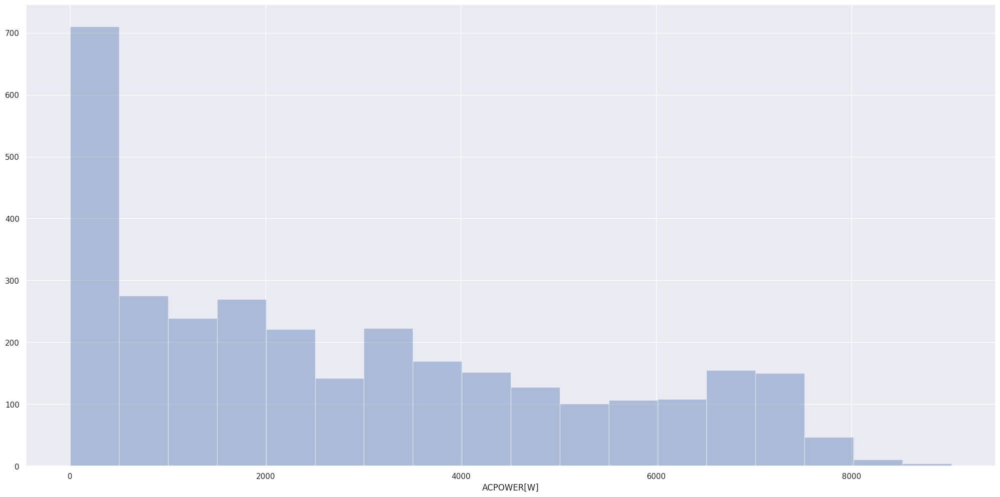

In [40]:
sns.distplot(df1['ACPOWER[W]'], kde=False);

### 4.1.2 Numerical Variable

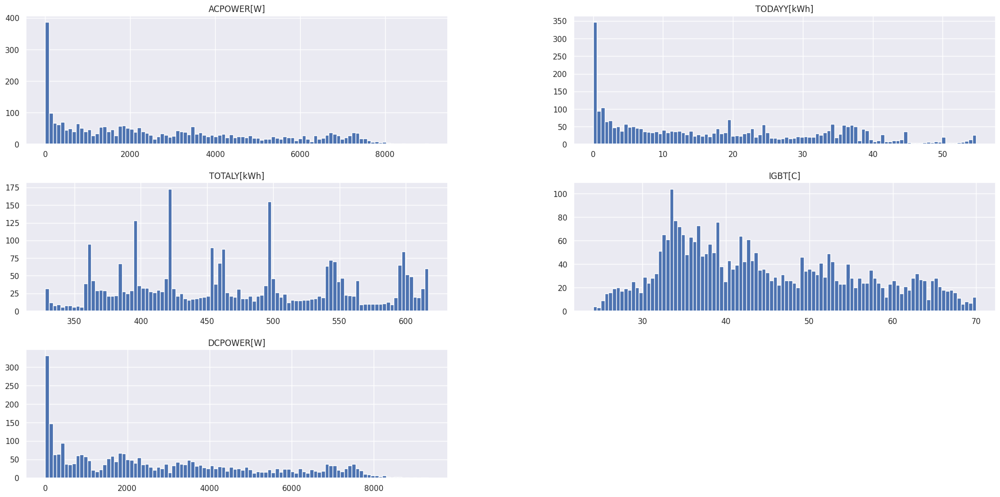

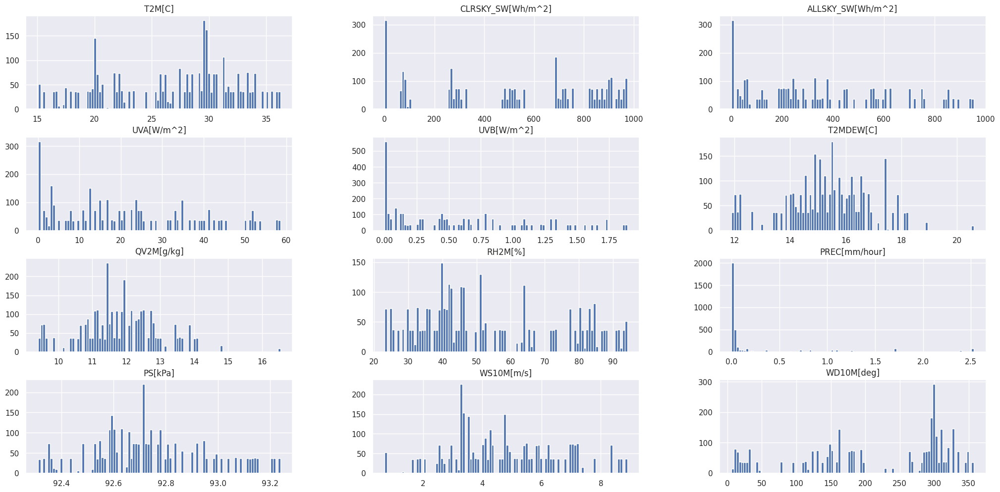

In [41]:
num_attributes = df1.select_dtypes(include = ['int64', 'float64'])
num_attributes[['ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]']].hist(bins=100);
num_attributes[['T2M[C]', 'CLRSKY_SW[Wh/m^2]', 'ALLSKY_SW[Wh/m^2]', 'UVA[W/m^2]', 'UVB[W/m^2]', 'T2MDEW[C]', 'QV2M[g/kg]', 'RH2M[%]', 'PREC[mm/hour]', 'PS[kPa]', 'WS10M[m/s]', 'WD10M[deg]']].hist(bins=100);

### 4.1.3 Geração AC x DC

In [42]:
# Potência AC e DC média gerada em um período de 6 horas
fig = go.Figure(layout = layout)
fig.add_trace(go.Histogram(histfunc="avg", y=df1["DCPOWER[W]"], x=df1["TIME"], name="Potência DC"))
fig.add_trace(go.Histogram(histfunc="avg", y=df1["ACPOWER[W]"], x=df1["TIME"], name="Potência AC"))

fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.5)

fig.update_yaxes(title_text='Potência média (W)')

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'histfunc': 'avg',
              'name': 'Potência DC',
              'opacity': 0.5,
              'type': 'histogram',
              'x': array([datetime.datetime(2021, 10, 1, 4, 47, 39),
                          datetime.datetime(2021, 10, 1, 4, 47, 48),
                          datetime.datetime(2021, 10, 1, 4, 48, 2), ...,
                          datetime.datetime(2021, 10, 7, 17, 21, 36),
                          datetime.datetime(2021, 10, 7, 17, 23),
                          datetime.datetime(2021, 10, 7, 17, 24, 7)], dtype=object),
              'y': array([30., 37., 36., ..., 48., 38., 33.])},
             {'histfunc': 'avg',
              'name': 'Potência AC',
              'opacity': 0.5,
              'type': 'histogram',
              'x': array([datetime.datetime(2021, 10, 1, 4, 47, 39),
                          datetime.datetime(2021, 10, 1, 4, 47, 48),
                          datetime.datetime(2021, 10, 1, 4, 48, 2), ...,
                          datetime.datetime(2021, 10, 7, 17, 21, 36),
                          datetime.datetime(2021, 10, 7, 17, 23),
                          datetime.datetime(2021, 10, 7, 17, 24, 7)], dtype=object),
              'y': array([20., 20., 20., ..., 20., 20., 20.])}],
    'layout': {'autosize': False,
               'barmode': 'overlay',
               'height': 250,
               'margin': {'b': 10, 'l': 10, 'pad': 6, 'r': 10, 't': 10},
               'template': '...',
               'width': 800,
               'yaxis': {'title': {'text': 'Potência média (W)'}}}
})

In [40]:
# Potência AC e DC total gerada em um período de 6 horas
fig = go.Figure(layout = layout)
fig.add_trace(go.Histogram(histfunc="sum", y=df1["DCPOWER[W]"], x=df1["TIME"], name="Potência DC"))
fig.add_trace(go.Histogram(histfunc="sum", y=df1["ACPOWER[W]"], x=df1["TIME"], name="Potência AC"))

fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.5)

fig.update_yaxes(title_text='Potência média (W)')

Perdas média:  96.89994729244799


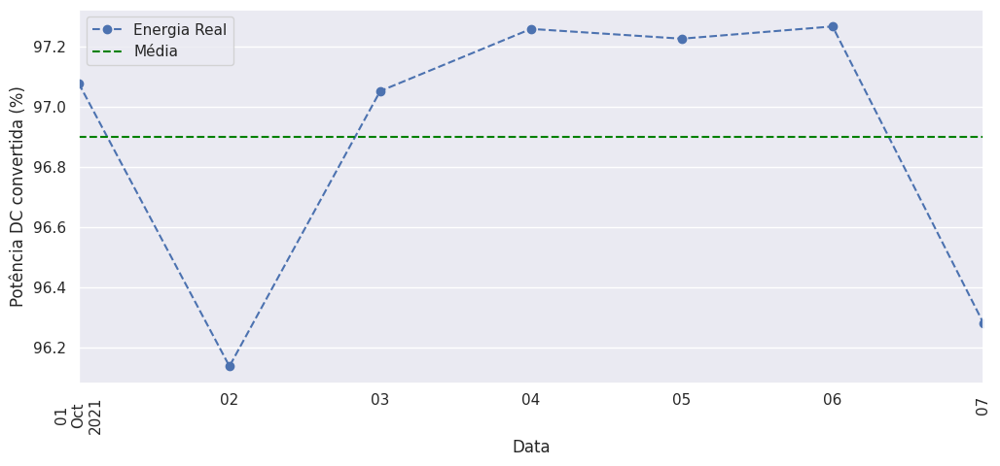

In [43]:
# Perdas na geração de energia
perdas=df1.copy() # Copia conteúdo da tabela de dados da planta
perdas=perdas[['ACPOWER[W]', 'DCPOWER[W]', 'DATE']].groupby('DATE').sum() # Agrupa todos os dados para as 34 datas
perdas['perdas']=perdas['ACPOWER[W]']/perdas['DCPOWER[W]']*100 # Reune os dados de energia real convertida

perdas['perdas'].plot(style='o--',figsize=(12,5),label='Energia Real') # Plota os dados de energia real convertida

print('Perdas média: ', perdas['perdas'].mean())

plt.ylabel('Potência DC convertida (%)',fontsize=12)
plt.xlabel('Data',fontsize=12)
plt.axhline(perdas['perdas'].mean(),linestyle='--',color='green',label='Média') # Plota linha com a média dos dados de energia convertida
plt.xticks(rotation = 90)
plt.legend()
plt.show();

### 4.1.4 Irradiação

In [46]:
# Irradiação média gerada em um período de 6 horas
fig = go.Figure(layout = layout)
fig = px.histogram(df1, labels={"TIME": "Data"}, x="TIME", y="ALLSKY_SW[Wh/m^2]", histfunc='avg')
fig.update_yaxes(title_text='Irradiação média (Wh/m²)')

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'bingroup': 'x',
              'histfunc': 'avg',
              'hovertemplate': 'Data=%{x}<br>avg of ALLSKY_SW[Wh/m^2]=%{y}<extra></extra>',
              'legendgroup': '',
              'marker': {'color': '#636efa', 'pattern': {'shape': ''}},
              'name': '',
              'offsetgroup': '',
              'orientation': 'v',
              'showlegend': False,
              'type': 'histogram',
              'x': array([datetime.datetime(2021, 10, 1, 4, 47, 39),
                          datetime.datetime(2021, 10, 1, 4, 47, 48),
                          datetime.datetime(2021, 10, 1, 4, 48, 2), ...,
                          datetime.datetime(2021, 10, 7, 17, 21, 36),
                          datetime.datetime(2021, 10, 7, 17, 23),
                          datetime.datetime(2021, 10, 7, 17, 24, 7)], dtype=object),
              'xaxis': 'x',
              'y': array([ 0.  ,  0.  ,  0.  , ..., 30.43, 30.43, 30.43]),
              'yaxis': 'y'}],
    'layout': {'barmode': 'relative',
               'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y', 'domain': [0.0, 1.0], 'title': {'text': 'Data'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'Irradiação média (Wh/m²)'}}}
})

### 4.1.5 Temperatura

In [43]:
fig = go.Figure(layout = layout)
fig.add_trace(go.Histogram(histfunc="avg", y=df1['IGBT[C]'], x=df1['TIME'], name="IGBT"))
fig.add_trace(go.Histogram(histfunc="avg", y=df1['T2M[C]'], x=df1['TIME'], name="Temp Ambiente"))

fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.5)

fig.update_yaxes(title_text='Temperatura média (ºC)')

### 4.1.6 Geração Horária

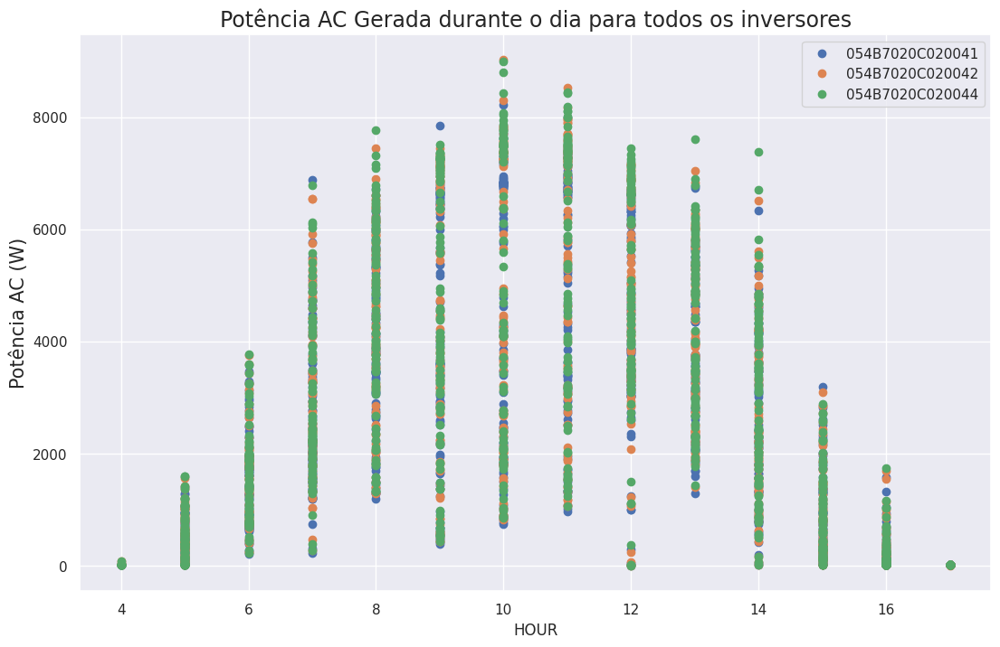

In [47]:
inversores = df1.copy()
inversores.set_index('HOUR').groupby('INVERTER')['ACPOWER[W]'].plot(style='o', legend=True, figsize=(13,8))

plt.title('Potência AC Gerada durante o dia para todos os inversores', size=17)
plt.ylabel('Potência AC (W)', fontsize=15)
plt.legend()
plt.show()

In [48]:
# Removendo intervalo onde a geração de enegia é nula
filtro = (df1['TIME'].dt.hour > 4) & (df1['TIME'].dt.hour < 17)
df4 = df1[filtro]

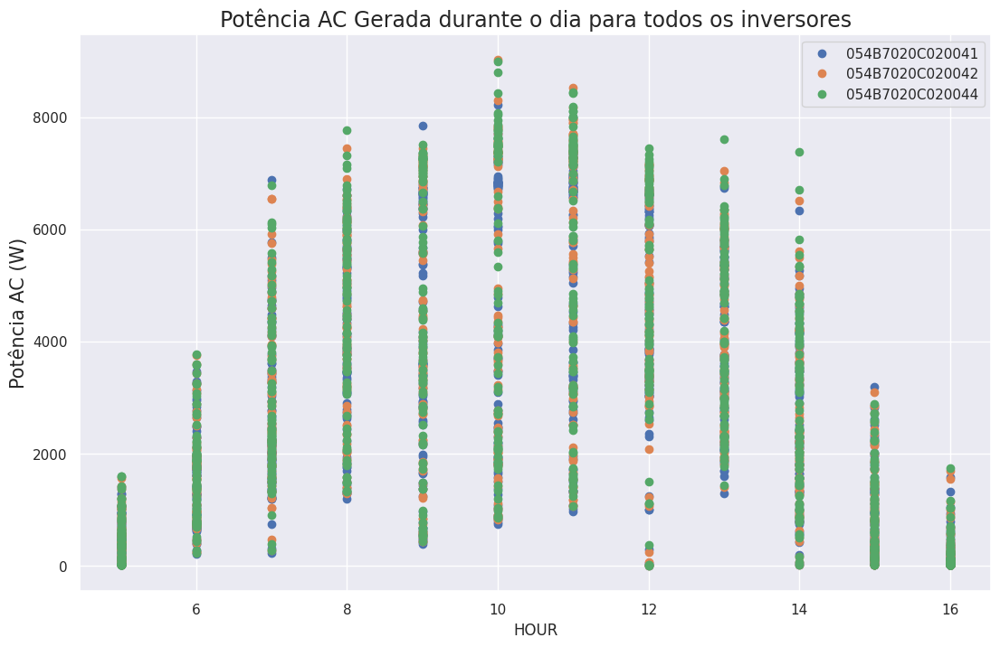

In [49]:
# gráfico sem os dados de geração nula
inversores = df4.copy()
inversores.set_index('HOUR').groupby('INVERTER')['ACPOWER[W]'].plot(style='o', legend=True, figsize=(13,8))

plt.title('Potência AC Gerada durante o dia para todos os inversores', size=17)
plt.ylabel('Potência AC (W)', fontsize=15)
plt.legend()
plt.show()

In [50]:
df1 = df4.copy()

### 4.1.7 Verificação de valores nulos de geração

In [51]:
# Reunir os valores nulos de energia
dataframe = df1.copy()
filtro = df1['ACPOWER[W]'] == 0

geracaoACNula = dataframe[filtro]

# Histograma com as quantidade de valores nulos 
diasNulos = geracaoACNula['HOUR']

fig = px.histogram(geracaoACNula, labels={"x": "Data"}, x=diasNulos, y="ACPOWER[W]", histfunc='count')
fig.update_yaxes(title_text='Quantidade de valores nulos')

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'bingroup': 'x',
              'histfunc': 'count',
              'hovertemplate': 'HOUR=%{x}<br>count=%{y}<extra></extra>',
              'legendgroup': '',
              'marker': {'color': '#636efa', 'pattern': {'shape': ''}},
              'name': '',
              'offsetgroup': '',
              'orientation': 'v',
              'showlegend': False,
              'type': 'histogram',
              'x': array([12, 12, 12], dtype=int32),
              'xaxis': 'x',
              'y': array([0., 0., 0.]),
              'yaxis': 'y'}],
    'layout': {'barmode': 'relative',
               'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y', 'domain': [0.0, 1.0], 'title': {'text': 'HOUR'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'Quantidade de valores nulos'}}}
})

In [52]:
# Histograma com a média de irradiação para quando a geração de energia foi nula
diasNulos = geracaoACNula['HOUR']

fig = go.Figure(layout = layout)
fig = px.histogram(geracaoACNula, labels={'x': "Hora"}, x=diasNulos, y="ALLSKY_SW[Wh/m^2]", histfunc='avg')
fig.update_yaxes(title_text='Irradiação solar média para os valores nulos (Wh/m²)')

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'bingroup': 'x',
              'histfunc': 'avg',
              'hovertemplate': 'HOUR=%{x}<br>avg of ALLSKY_SW[Wh/m^2]=%{y}<extra></extra>',
              'legendgroup': '',
              'marker': {'color': '#636efa', 'pattern': {'shape': ''}},
              'name': '',
              'offsetgroup': '',
              'orientation': 'v',
              'showlegend': False,
              'type': 'histogram',
              'x': array([12, 12, 12], dtype=int32),
              'xaxis': 'x',
              'y': array([621.93, 621.93, 621.93]),
              'yaxis': 'y'}],
    'layout': {'barmode': 'relative',
               'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y', 'domain': [0.0, 1.0], 'title': {'text': 'HOUR'}},
               'yaxis': {'anchor': 'x',
                         'domain': [0.0, 1.0],
                         'title': {'text': 'Irradiação solar média para os valores nulos (Wh/m²)'}}}
})

### 4.1.8 Geração dos 7 dias para cada inversor

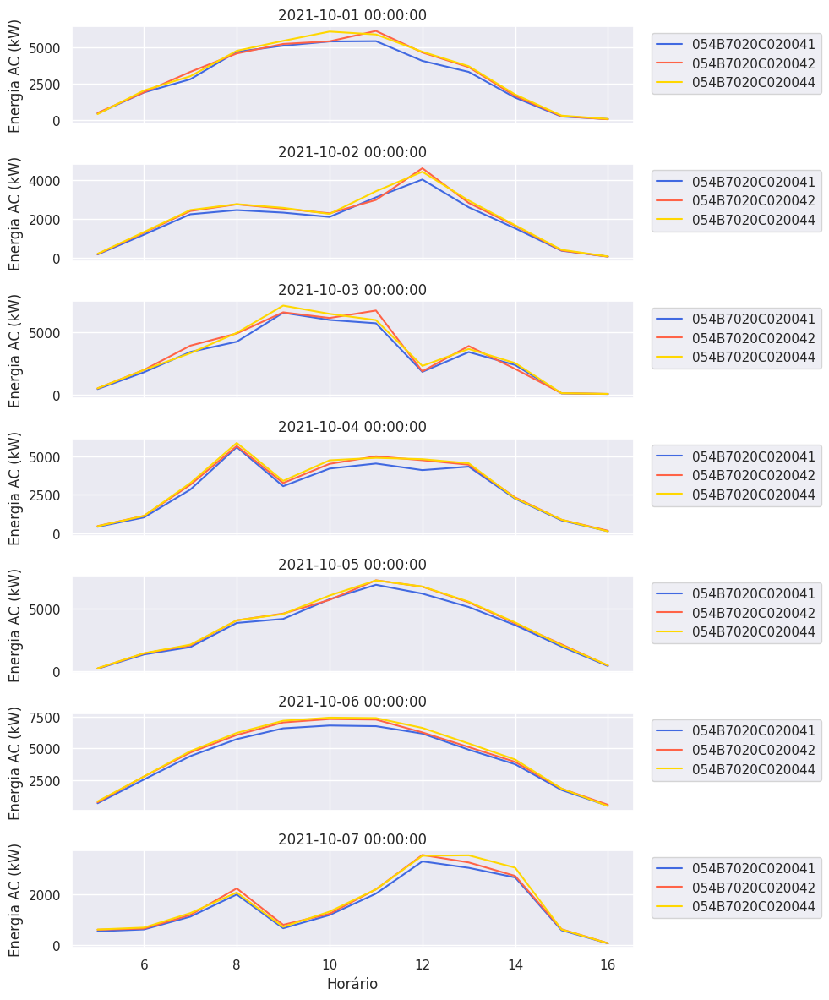

In [54]:
geracao=df1.copy()

geracao['Horário']=geracao['HOUR']
geracao['Data']=geracao['DATE']

cols=geracao.groupby(['Horário','Data'])['ACPOWER[W]'].mean().unstack()

inversores = ['054B7020C020041', '054B7020C020042', '054B7020C020044']
cores = ['royalblue', 'tomato', 'gold']

inversores_1=df1.loc[df1['INVERTER']=='054B7020C020041'].loc[df1['DATE'] < ('2021-10-08')]#atualização de data($ df1['date']>('2021-10-02'))
inversores_1['Horário']=inversores_1['HOUR']
inversores_1['Data']=inversores_1['DATE']

ax=inversores_1.groupby(['Horário','Data'])['ACPOWER[W]'].mean().unstack().plot(sharex=True,subplots=True,layout=(7,1),figsize=(10,12), color=cores[0])

j=1
for j in range(1,3):
    inversores_2 =df1.loc[df1['INVERTER']==inversores[j]].loc[df1['DATE'] < ('2021-10-08')]#atualização de data($ df1['date']>('2021-10-02'))
    inversores_2['Horário']=inversores_2['HOUR']
    inversores_2['Data']=inversores_2['DATE']
    inversores_2.groupby(['Horário','Data'])['ACPOWER[W]'].mean().unstack().plot(sharex=True,subplots=True,layout=(7,1),figsize=(10,12), color=cores[j], ax=ax)
    j=j+1

i=0
for linha in range(len(ax)):
    for coluna in range(len(ax[linha])):
        ax[linha,coluna].set_title(cols.columns[i],size=12)
        ax[linha,coluna].set_ylabel('Energia AC (kW)')
        ax[linha,coluna].legend(inversores, bbox_to_anchor = (1.02, 1))
        i=i+1

plt.tight_layout()
plt.show()

### 4.1.9 Outliers

In [55]:
def boxplot_individuais(data, colunas, largura = 10, altura = 8):
    fig = plt.figure()
    fig.subplots_adjust(hspace = 0.4, wspace = 0.4)
    fig.set_figheight(altura)
    fig.set_figwidth(largura)
    
    ajusteColunas = math.ceil(len(colunas) / 2)
    
    for i, coluna in enumerate(colunas):
        ax = fig.add_subplot(ajusteColunas, 2, i + 1)
        sns.boxplot(x = data[coluna])
        
    plt.tight_layout()
    plt.show()

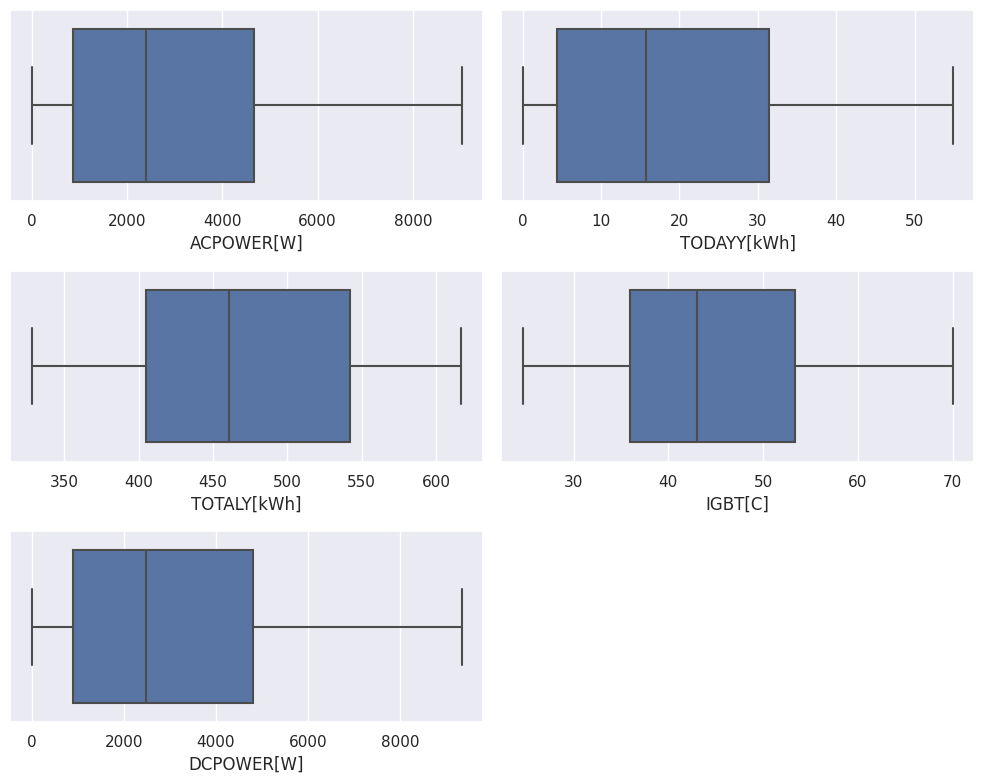

In [56]:
# Retira valores qualitativos da amostra (Data e número de identificação dos inversores)
quantitativos = df1.drop(['INVERTER', 'TIME', 'DATE', 'YEAR', 'MONTH', 'DAY', 'HOUR', 'MIN', 'DAY_WEEK', 'WEEK_YEAR'], axis = 1).columns

boxplot_individuais(df1, quantitativos[0:5])

## 4.2 Análise Multivariada

### 4.2.1 Correlação

In [57]:
corr_matrix = df1.drop('INVERTER', axis=1).corr()

corr_matrix["ACPOWER[W]"].sort_values(ascending=False)

ACPOWER[W]           1.000000
DCPOWER[W]           0.999860
IGBT[C]              0.899823
ALLSKY_SW[Wh/m^2]    0.799405
UVA[W/m^2]           0.779851
UVB[W/m^2]           0.742463
CLRSKY_SW[Wh/m^2]    0.605052
PS[kPa]              0.367802
T2M[C]               0.281696
WD10M[deg]           0.181625
PREC[mm/hour]        0.122364
TODAYY[kWh]          0.107319
WEEK_YEAR            0.088717
WS10M[m/s]           0.078041
TOTALY[kWh]          0.031997
DATE                 0.030134
DAY                  0.030134
TIME                 0.026876
MIN                  0.015145
HOUR                -0.045753
DAY_WEEK            -0.123836
T2MDEW[C]           -0.213256
QV2M[g/kg]          -0.233623
RH2M[%]             -0.325942
YEAR                      NaN
MONTH                     NaN
Name: ACPOWER[W], dtype: float64

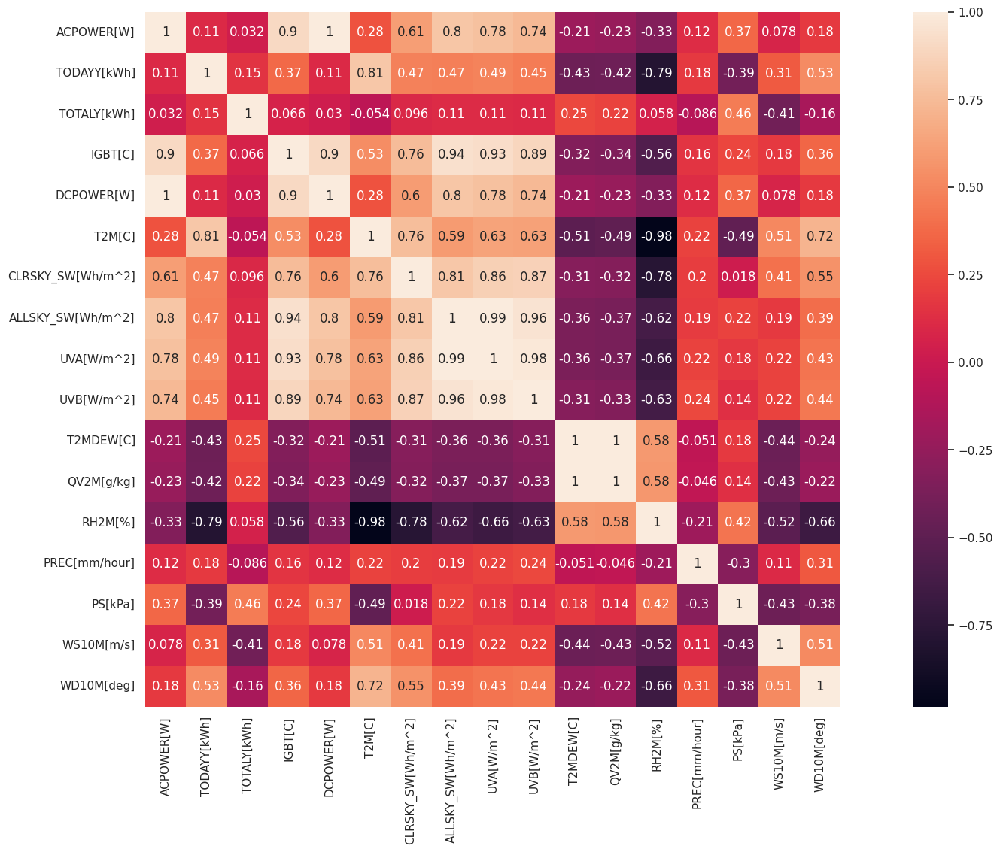

In [58]:
fig = plt.figure()

sns.heatmap(df1.drop(['INVERTER', 'TIME', 'DATE', 'YEAR', 'MONTH', 'DAY', 'HOUR', 'MIN', 'DAY_WEEK', 'WEEK_YEAR'], axis=1).corr(method = 'pearson'), annot = True, square = True)
plt.show()

# 5.0 DATA PREPARATION

In [59]:
dfAcPowerT.sample(20)

,Time,Total Inverter Power(W)
508,2021-10-04 09:52:07,9320.0
765,2021-10-06 05:43:23,1510.0
1003,2021-10-07 12:30:57,7490.0
24,2021-10-01 06:48:36,6280.0
618,2021-10-05 06:23:27,2290.0
897,2021-10-06 16:39:28,2400.0
146,2021-10-01 16:55:32,60.0
452,2021-10-04 05:11:35,180.0
332,2021-10-03 07:38:05,9760.0
395,2021-10-03 12:51:57,6620.0


## 5.1 Split dataframe into training and test dataset

In [76]:
# training dataset
df1_train = df1[df1['DATE'] < '2021-10-06']

# test dataset
df1_test = df1[df1['DATE'] >= '2021-10-06']

print('Training Min Date: {}'.format(df1_train['DATE'].min()))
print('Training Max Date: {}'.format(df1_train['DATE'].max()))

print('\nTest Date Min Date: {}'.format(df1_test['DATE'].min()))
print('Test Max Date: {}'.format(df1_test['DATE'].max()))

Training Min Date: 2021-10-01 00:00:00
Training Max Date: 2021-10-05 00:00:00

Test Date Min Date: 2021-10-06 00:00:00
Test Max Date: 2021-10-07 00:00:00


In [78]:
df1_train.head()

,TIME,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,T2M[C],CLRSKY_SW[Wh/m^2],ALLSKY_SW[Wh/m^2],...,WS10M[m/s],WD10M[deg],DATE,YEAR,MONTH,WEEK_YEAR,DAY_WEEK,DAY,HOUR,MIN
9,2021-10-01 05:02:42,20.0,0.0,359.0,27.1,90.0,054B7020C020044,17.54,0.0,0.0,...,3.32,33.09,2021-10-01,2021,10,39,5,1,5,2
10,2021-10-01 05:02:52,20.0,0.0,328.0,28.4,82.0,054B7020C020041,17.54,0.0,0.0,...,3.32,33.09,2021-10-01,2021,10,39,5,1,5,2
11,2021-10-01 05:03:09,20.0,0.0,359.0,27.9,104.0,054B7020C020042,17.54,0.0,0.0,...,3.32,33.09,2021-10-01,2021,10,39,5,1,5,3
12,2021-10-01 05:07:47,20.0,0.0,359.0,27.7,93.0,054B7020C020044,17.54,0.0,0.0,...,3.32,33.09,2021-10-01,2021,10,39,5,1,5,7
13,2021-10-01 05:07:56,20.0,0.0,328.0,29.0,84.0,054B7020C020041,17.54,0.0,0.0,...,3.32,33.09,2021-10-01,2021,10,39,5,1,5,7


## 5.2 Standardization

In [62]:
ss = pp.StandardScaler()

## 5.3 Rescaling

In [63]:
mms = pp.MinMaxScaler()
mms_y = pp.MinMaxScaler()

In [64]:
def RescalingMMS(df):
    df['ACPOWER[W]']  = mms_y.fit_transform(df[['ACPOWER[W]']].values)
    df['TODAYY[kWh]'] = mms_y.fit_transform(df[['TODAYY[kWh]']].values)
    df['TOTALY[kWh]'] = mms_y.fit_transform(df[['TOTALY[kWh]']].values)
    df['IGBT[C]']     = mms_y.fit_transform(df[['IGBT[C]']].values)
    df['DCPOWER[W]']  = mms_y.fit_transform(df[['DCPOWER[W]']].values)
    df['T2M[C]']      = mms_y.fit_transform(df[['T2M[C]']].values)
    df['CLRSKY_SW[Wh/m^2]'] = mms_y.fit_transform(df[['CLRSKY_SW[Wh/m^2]']].values)
    df['ALLSKY_SW[Wh/m^2]'] = mms_y.fit_transform(df[['ALLSKY_SW[Wh/m^2]']].values)
    df['UVA[W/m^2]'] = mms_y.fit_transform(df[['UVA[W/m^2]']].values)
    df['UVB[W/m^2]'] = mms_y.fit_transform(df[['UVB[W/m^2]']].values)
    df['T2MDEW[C]'] = mms_y.fit_transform(df[['T2MDEW[C]']].values)
    df['QV2M[g/kg]'] = mms_y.fit_transform(df[['QV2M[g/kg]']].values)
    df['RH2M[%]'] = mms_y.fit_transform(df[['RH2M[%]']].values)
    df['PREC[mm/hour]'] = mms_y.fit_transform(df[['PREC[mm/hour]']].values)
    df['PS[kPa]'] = mms_y.fit_transform(df[['PS[kPa]']].values)
    df['WS10M[m/s]'] = mms_y.fit_transform(df[['WS10M[m/s]']].values)

In [65]:
RescalingMMS(df1_train)
RescalingMMS(df1_test)

## 5.4 Nature Transformation

### 5.4.1 Training

In [80]:
df1_train['month_sin'] = df1_train['MONTH'].apply(lambda x: np.sin(x * (2 * np.pi/12)))
df1_train['month_cos'] = df1_train['MONTH'].apply(lambda x: np.cos(x * (2 * np.pi/12)))

df1_train['week_of_year_sin'] = df1_train['WEEK_YEAR'].apply(lambda x: np.sin(x * (2 * np.pi/52)))
df1_train['week_of_year_cos'] = df1_train['WEEK_YEAR'].apply(lambda x: np.cos(x * (2 * np.pi/52)))

df1_train['day_of_week_sin'] = df1_train['DAY_WEEK'].apply(lambda x: np.sin(x * (2 * np.pi/7)))
df1_train['day_of_week_cos'] = df1_train['DAY_WEEK'].apply(lambda x: np.cos(x * (2 * np.pi/7)))

df1_train['day_sin'] = df1_train['DAY'].apply(lambda x: np.sin(x * (2 * np.pi/30)))
df1_train['day_cos'] = df1_train['DAY'].apply(lambda x: np.cos(x * (2 * np.pi/30)))

df1_train['hour_sin'] = df1_train['HOUR'].apply(lambda x: np.sin(x * (2 * np.pi/24)))
df1_train['hour_cos'] = df1_train['HOUR'].apply(lambda x: np.cos(x * (2 * np.pi/24)))

df1_train['minute_sin'] = df1_train['MIN'].apply(lambda x: np.sin(x * (2 * np.pi/60)))
df1_train['minute_cos'] = df1_train['MIN'].apply(lambda x: np.cos(x * (2 * np.pi/60)))

cols_drop = ['MONTH', 'WEEK_YEAR', 'DAY_WEEK', 'DAY', 'HOUR', 'MIN', 'DATE']
df1_train = df1_train.drop(cols_drop, axis = 1)

### 5.4.2 Test

In [81]:
df1_test['month_sin'] = df1_test['MONTH'].apply(lambda x: np.sin(x * (2 * np.pi/12)))
df1_test['month_cos'] = df1_test['MONTH'].apply(lambda x: np.cos(x * (2 * np.pi/12)))

df1_test['week_of_year_sin'] = df1_test['WEEK_YEAR'].apply(lambda x: np.sin(x * (2 * np.pi/52)))
df1_test['week_of_year_cos'] = df1_test['WEEK_YEAR'].apply(lambda x: np.cos(x * (2 * np.pi/52)))

df1_test['day_of_week_sin'] = df1_test['DAY_WEEK'].apply(lambda x: np.sin(x * (2 * np.pi/7)))
df1_test['day_of_week_cos'] = df1_test['DAY_WEEK'].apply(lambda x: np.cos(x * (2 * np.pi/7)))

df1_test['day_sin'] = df1_test['DAY'].apply(lambda x: np.sin(x * (2 * np.pi/30)))
df1_test['day_cos'] = df1_test['DAY'].apply(lambda x: np.cos(x * (2 * np.pi/30)))

df1_test['hour_sin'] = df1_test['HOUR'].apply(lambda x: np.sin(x * (2 * np.pi/24)))
df1_test['hour_cos'] = df1_test['HOUR'].apply(lambda x: np.cos(x * (2 * np.pi/24)))

df1_test['minute_sin'] = df1_test['MIN'].apply(lambda x: np.sin(x * (2 * np.pi/60)))
df1_test['minute_cos'] = df1_test['MIN'].apply(lambda x: np.cos(x * (2 * np.pi/60)))

cols_drop = ['MONTH', 'WEEK_YEAR', 'DAY_WEEK', 'DAY', 'HOUR', 'MIN', 'DATE']
df1_test = df1_test.drop(cols_drop, axis = 1)

# 6.0 FEATURE SELECTION

## 6.1 Feature Selection df1

### 6.1.1 Target variable

In [82]:
# training dataset
y_train = df1_train[['ACPOWER[W]']]

# test dataset
y_test = df1_test[['ACPOWER[W]']]

### 6.1.2 Boruta as Feature Selector

In [83]:
# training and test dataset for Boruta
X_train_n = df1_train.drop(['TIME', 'ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]', 'INVERTER'], axis = 1).values
y_train_n = y_train.values.ravel() # ravel is to vetorize the values

In [84]:
# define randomforestregressor
rf = RandomForestRegressor(n_jobs = -1)

In [89]:
boruta = BorutaPy(rf, n_estimators = 'auto', verbose = 2, random_state = 42).fit(X_train_n, y_train_n)

AttributeError: module 'numpy' has no attribute 'int'.
`np.int` was a deprecated alias for the builtin `int`. To avoid this error in existing code, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
The aliases was originally deprecated in NumPy 1.20; for more details and guidance see the original release note at:
    https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

### 6.2.1 Best Features from Boruta

In [87]:
cols_selected = boruta.support_.tolist()

# best features
X_train_fs_41 = df1_train.drop(['TIME', 'ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]', 'INVERTER'], axis = 1) 

NameError: name 'boruta' is not defined

In [67]:
cols_selected_boruta = X_train_fs_41.iloc[:, cols_selected].columns.to_list()

In [68]:
cols_selected_boruta

['T2M[C]',
 'CLRSKY_SW[Wh/m^2]',
 'ALLSKY_SW[Wh/m^2]',
 'UVA[W/m^2]',
 'UVB[W/m^2]',
 'PS[kPa]',
 'WD10M[deg]',
 'hour_sin',
 'minute_sin',
 'minute_cos']

# 7.0 MACHINE LEARNING MODELING

In [69]:
x_train = df1_train[cols_selected_boruta]
x_test  = df1_test[cols_selected_boruta]

## 7.1 Random Forest Regressor

In [70]:
rf = RandomForestRegressor(n_estimators = 25, n_jobs = -1, random_state = 42).fit(x_train, y_train)

In [71]:
# prediction
yhat_rf = pd.DataFrame(rf.predict(x_test))

### 7.1.1 Normalized Data

In [72]:
# performance
rf_result = ml_error('Random forest Regressor', y_test, yhat_rf)
rf_result

,Model Name,MAE,MAPE,RMSE
0,Random forest Regressor,0.150158,3.425057e+11,0.203023


In [73]:
y_test = y_test.values
yhat_rf = yhat_rf.values

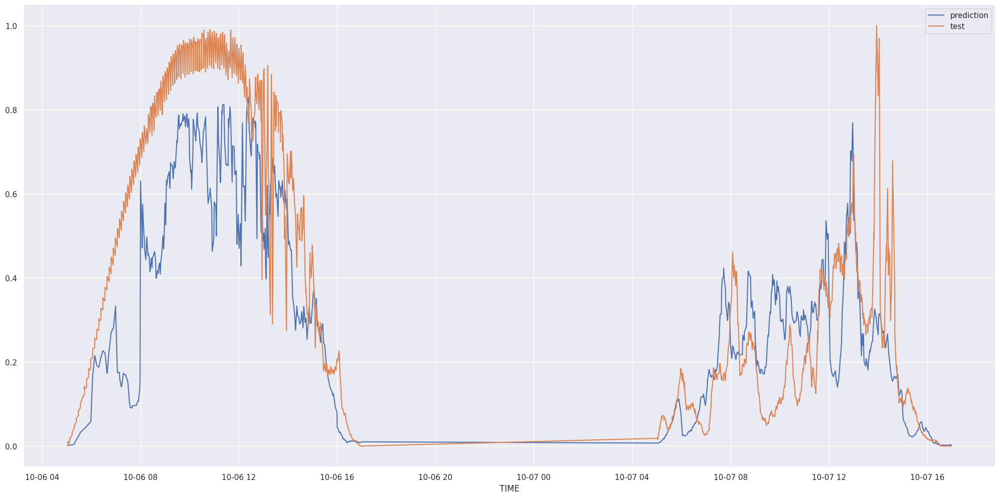

In [74]:
sns.lineplot(x = df1_test['TIME'], y = yhat_rf[:, 0], label = 'prediction')
sns.lineplot(x = df1_test['TIME'], y = y_test[:,0], label = 'test');

### 7.1.2 Inverse Transform

In [75]:
# performance
rf_result = ml_error('Random forest Regressor', mms_y.inverse_transform(y_test), mms_y.inverse_transform(yhat_rf))
rf_result

,Model Name,MAE,MAPE,RMSE
0,Random forest Regressor,0.83338,0.284104,1.126778


In [76]:
y_test = mms_y.inverse_transform(y_test)
yhat_rf = mms_y.inverse_transform(yhat_rf)

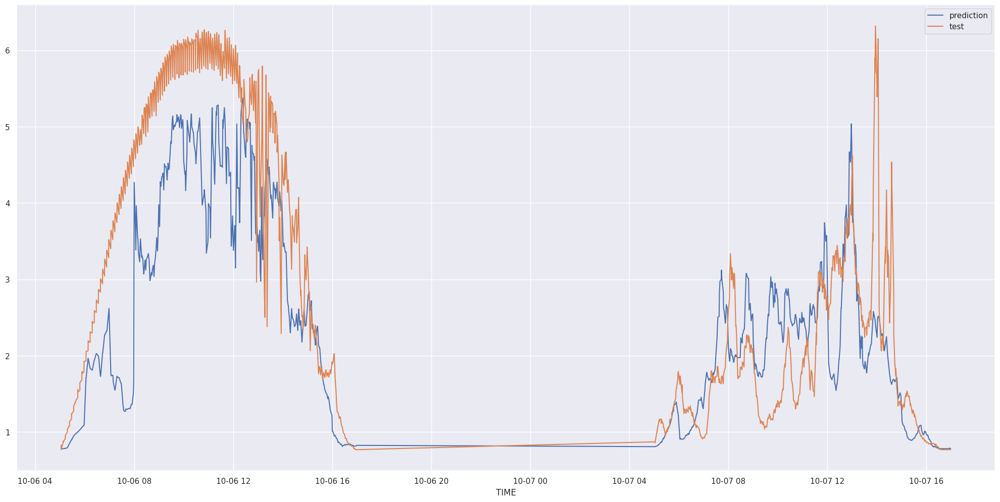

In [77]:
sns.lineplot(x = df1_test['TIME'], y = yhat_rf[:,0], label = 'prediction')
sns.lineplot(x = df1_test['TIME'], y = y_test[:,0], label = 'test');